We start out by importing the modules necessary for the strain analysis 

In [3]:
import numpy as np
from PIL import Image
from tifffile import imread
import cv2


import matplotlib.pyplot as plt
import importlib
import os


from strain_and_adip_tools.strain_inference import StrainInference




c:\Users\jakob\Documents\work\ADIP_quantification\ADIP_quantification_refactored\archive\aggregate_analysis.py:450: SyntaxWarning: invalid escape sequence '\p'
  extratitle = f"\n{len(angles)} cells | 1-Var: Mean {np.mean(protein_sigmas[protein_sizes>cutoff]):.3} $\pm$ {np.std(protein_sigmas[protein_sizes>cutoff]):.3}"
c:\Users\jakob\Documents\work\ADIP_quantification\ADIP_quantification_refactored\archive\aggregate_analysis.py:462: SyntaxWarning: invalid escape sequence '\c'
  extratitle += f"\n$\chi^2$ p-value: {cs.pvalue:.3} | $\chi^2$: {cs.statistic:.3}"
c:\Users\jakob\Documents\work\ADIP_quantification\ADIP_quantification_refactored\archive\aggregate_analysis.py:462: SyntaxWarning: invalid escape sequence '\c'
  extratitle += f"\n$\chi^2$ p-value: {cs.pvalue:.3} | $\chi^2$: {cs.statistic:.3}"
c:\Users\jakob\Documents\work\ADIP_quantification\ADIP_quantification_refactored\archive\aggregate_analysis.py:486: SyntaxWarning: invalid escape sequence '\c'
  extratitle += f"\n$NULL MODEL

Some housework is needed:

In [4]:
def if_possible_make_path(path):
    if not os.path.isdir(path):
        os.mkdir(path)

def read_image(path : str):
    # if tif file
    if path[-4:] == ".tif":
        img = imread(path)
        
        # Some of Sergei's images had channels on first axis. Take this into account.
        channels_index = np.argmin(img.shape)
        img = np.moveaxis(img, [channels_index], [-1])
        
        return img
    elif path[-4:] == ".png":
        return np.array(imread(path))
    
    raise ValueError("File type not supported")
        



super_path = "all_data_structured/"


# Okay, I am getting tired of this, so from now on:
# We will loop through all subfolders in the path.
# then chek if any of them have subfolders.
# If they do, we will loop through those as well.
# for each (sub)folder we will check if there is a .txt 
# file giving us the protein, cell and shroom channels and
# a subfolder titled "masks" with the masks.

# In parallel, a copy of the structure will be created in the
# output folder, where we will save the arrow results and readables
# in the same structure as the input.


all_folder_names = []

first_level = os.listdir(super_path)
for folder in first_level:
    if not os.path.isdir(super_path + folder) or folder == "masks":
        continue

    all_folder_names.append(folder)

for folder in all_folder_names:
    second_level = os.listdir(super_path + folder)
    for subfolder in second_level:
        if subfolder == "masks" or subfolder == "results":
            continue 

        if not os.path.isdir(super_path + folder + "/" + subfolder) or subfolder == "masks":
            continue
        
        all_folder_names.append(folder + "/" + subfolder)

        third_level = os.listdir(super_path + folder + "/" + subfolder)
        for subsubfolder in third_level:
            if not os.path.isdir(super_path + folder + "/" + subfolder + "/" + subsubfolder) or subsubfolder == "masks":
                continue
            
            all_folder_names.append(folder + "/" + subfolder + "/" + subsubfolder)




def check_if_valid_path(path):
    if not os.path.isdir(super_path + path + "/masks"):
        print("No masks folder in " + path)
        return False

    # check if there is a txt file with the channels
    if not os.path.isfile(super_path + path + "/channels.txt"):
        print("No channels.txt file in " + path)
        return False

    return True



all_folders = {}

for fold in all_folder_names:
    all_folders[fold] = {"is_valid" : check_if_valid_path(fold)}




for fold in all_folders.keys():
    if not all_folders[fold]["is_valid"]:
        continue

    with open(super_path + fold + "/channels.txt", "r") as f:
        lines = f.readlines()

        # protein, cell, shroom
        
        cs = [int(x.strip()) for x in lines]

        all_folders[fold]["channels"] = cs



No masks folder in ADIP FINAL
No masks folder in Fig1 Replications
No masks folder in Fig3 Replications
No masks folder in Fig7-DMZ-VMZ copy
No masks folder in FigS2
No masks folder in FigS4 Div copy
No masks folder in From Chih-Wen to Jakob
No masks folder in From Satheeja to Jakob
No masks folder in New Fig1
No masks folder in ADIP in NP/unused
No masks folder in ADIP in NP/wounds
No masks folder in Fig2-Shrm3-polarization copy/controls for shroom3
No masks folder in Fig2-Shrm3-polarization copy/wounds
No masks folder in Fig7-DMZ-VMZ copy/DMZ/results
No masks folder in Fig7-DMZ-VMZ copy/DMZ/wounds
No masks folder in Fig7-DMZ-VMZ copy/VMZ/results
No masks folder in Fig7-DMZ-VMZ copy/VMZ/wounds
No masks folder in From Chih-Wen to Jakob/R1-1-ADIP MYPT suction assay
No masks folder in From Chih-Wen to Jakob/R2-3-ADIP DYNAMICS in wound healing, MOVIES/results
No masks folder in From Chih-Wen to Jakob/R2-6 F-actin ADIPMO at wound edge/results
No masks folder in From Satheeja to Jakob/Fig R

In [5]:
list(filter(lambda x: x[1]["is_valid"], all_folders.items()))

[('ADIP dynamics in wound healing movie for Jakob NEW',
  {'is_valid': True, 'channels': [0, 1]}),
 ('ADIP in NP', {'is_valid': True, 'channels': [0, 2, 1]}),
 ('Fig2-Shrm3-polarization copy', {'is_valid': True, 'channels': [1, 2, 0]}),
 ('FigS1 Replicatons', {'is_valid': True, 'channels': [0, 1]}),
 ('Fig7-DMZ-VMZ copy/DMZ', {'is_valid': True, 'channels': [1, 0]}),
 ('Fig7-DMZ-VMZ copy/VMZ', {'is_valid': True, 'channels': [1, 0]}),
 ('From Chih-Wen to Jakob/R1-1-ADIP MYPT suction assay/Mypt',
  {'is_valid': True, 'channels': [0, 2, 1]}),
 ('From Chih-Wen to Jakob/R1-1-ADIP MYPT suction assay/Mypt Control',
  {'is_valid': True, 'channels': [0, 2, 1]}),
 ('From Chih-Wen to Jakob/R1-1-ADIP MYPT suction assay/Not Mypt',
  {'is_valid': True, 'channels': [0, 2, 1]}),
 ('From Chih-Wen to Jakob/R1-1-ADIP MYPT suction assay/Not Mypt Control',
  {'is_valid': True, 'channels': [0, 2, 1]}),
 ('From Chih-Wen to Jakob/R2-3-ADIP DYNAMICS in wound healing, MOVIES',
  {'is_valid': True, 'channels': [0

If there is no segmentations for the images, run the following cell:  

Finally, the analysis can commence:

In [ ]:
PROTEIN_SENSITIVITY = 0.2  # sensitivity percentage between 0 and 1

def preprocess_image(img_nolog):
    img_nolog_is_zero = np.logical_or(img_nolog == 0., img_nolog == 1.)
    img_nolog[img_nolog_is_zero] = img_nolog[~img_nolog_is_zero].min()
    print(img_nolog.min(), img_nolog.max())
    img = np.log(img_nolog)

    img[img < 4.5] = 4.5 # catch the -inf and 0 values

    return img


def do_single_image_analysis(fold, img, img_name,  show_images = False, do_corner_analysis = False, do_protein_analysis = True, do_actin_analysis = False, do_actin_null_model = False):
    assert do_protein_analysis or do_corner_analysis or do_actin_analysis or do_actin_null_model, "You must do either protein, corner or actin analysis or actin null model"

    path = super_path + fold + "/"
    mask_path = path + "masks/"
    result_path = path + "results/"
    if not os.path.isdir(result_path):
        print("Creating result path")
        os.mkdir(result_path)
    pc, cc = all_folders[fold]["channels"][:2]

    ac = -1
    
    # remove all channels except the cell channel and the protein channel
    img_protein = img[:,:,pc]
    img_cell = img[:,:,cc]

    if (len(all_folders[fold]["channels"]) == 3):
        ac = all_folders[fold]["channels"][2]

    print("AC", ac)


    print("Doing analysis of " + img_name)

    
    if show_images:
        # split the image into its channels
        fig, ax = plt.subplots(1, img.shape[2], figsize = (img.shape[2]*7, 7))
        for i in range(img.shape[2]):
            ax[i].imshow(img[:,:,i])

            if i == pc:
                ax[i].set_title("Protein Channel")
            elif i == cc:
                ax[i].set_title("Cell Channel")
            elif i == ac:
                ax[i].set_title("Actin Channel")

        fig.suptitle(img_name)
        fig.tight_layout()
        plt.show()

    # find the masks
    mask_path_individual = mask_path + "mask_" + img_name + '.npy'

    # check if the mask exists
    shouldreturn = False
    if not os.path.isfile(mask_path_individual):
        print("No mask found at " + mask_path_individual)
        shouldreturn = True
    
    img_name = img_name.replace("+","")

    if shouldreturn and not os.path.isfile(mask_path_individual):
        mask_path_individual = mask_path + "mask_" + img_name + '.npy'
        print("No mask found at " + mask_path_individual,"either")
        shouldreturn = True
    else:
        shouldreturn = False
        
    if shouldreturn:
        print("Aborting! Skipping " + img_name)
        return
    # make image savepath
    
    img_path = result_path + "images/"
    if not os.path.isdir(img_path):
        os.mkdir(img_path)
        
    img_actin = None if ac == -1 else img[:,:,ac]

    strain_inferer = StrainInference(img_cell, img_protein, mask_path_individual, protein_sensitivity = PROTEIN_SENSITIVITY, show_images = show_images, name = img_name, img_savepath = img_path, img_actin=img_actin)
    # return strain_inferer
    def save_csv(name, arr):
        np.savetxt(name + ".csv", arr, delimiter = ",")
    

    # do the protein analysis
    if do_protein_analysis:
        protein_arrows, protein_positions, protein_ids, protein_magnitudes, protein_sizes = strain_inferer.do_protein_part()

        protpath = result_path + "protein/"
        if not os.path.isdir(protpath):
            os.mkdir(protpath)
        save_csv(protpath + "protein_arrows_"    + img_name, protein_arrows)
        save_csv(protpath + "protein_positions_" + img_name, protein_positions)
        save_csv(protpath + "protein_ids_" + img_name, protein_ids)
        save_csv(protpath + "protein_magnitudes_" + img_name, protein_magnitudes)
        save_csv(protpath + "protein_sizes_" + img_name, protein_sizes)

    if do_corner_analysis:
        protein_positions, protein_ids, protein_sizes, corner_positions, corner_ids, border = strain_inferer.do_corner_analysis(count_borders = True)
        protpath = result_path + "corner/"
        if not os.path.isdir(protpath):
            os.mkdir(protpath)

        save_csv(protpath + "protein_positions_" + img_name, protein_positions)
        save_csv(protpath + "corner_positions_" + img_name, corner_positions)
        save_csv(protpath + "protein_sizes_" + img_name, protein_sizes)
        save_csv(protpath + "corner_ids_" + img_name, corner_ids)
        save_csv(protpath + "protein_ids_" + img_name, protein_ids)
        save_csv(protpath + "on_border_" + img_name, border)

    if do_actin_analysis:
        actin_arrows, actin_positions, actin_ids, actin_magnitudes = strain_inferer.do_actin_part()

        actpath = result_path + "actin/"
        if not os.path.isdir(actpath):
            os.mkdir(actpath)
        save_csv(actpath + "actin_arrows_"    + img_name, actin_arrows)
        save_csv(actpath + "actin_positions_" + img_name, actin_positions)
        save_csv(actpath + "actin_ids_" + img_name, actin_ids)
        save_csv(actpath + "actin_magnitudes_" + img_name, actin_magnitudes)

        print("Finished actin analysis of " + img_name)

    if do_actin_null_model:
        null_arrows, null_positions, null_ids, null_magnitudes = strain_inferer.do_multiple_actin_null_models(n_repeats = 100)

        actpath = result_path + "actin_null/"
        if not os.path.isdir(actpath):
            os.mkdir(actpath)
        save_csv(actpath + "null_arrows_"    + img_name, null_arrows)
        save_csv(actpath + "null_positions_" + img_name, null_positions)
        save_csv(actpath + "null_ids_" + img_name, null_ids)
        save_csv(actpath + "null_magnitudes_" + img_name, null_magnitudes)

        print("Finished actin null_model analysis of " + img_name)

WORKING ON FOLDER:  From Satheeja to Jakob/Fig7 Stretch with Morphants/Fig7 PanelA ADIP-Stretch
ERROR:  File type not supported for channels.txt
108 2340
AC 0
Doing analysis of Fig7 PanelA GFPADIP st11.5 stretch emb1


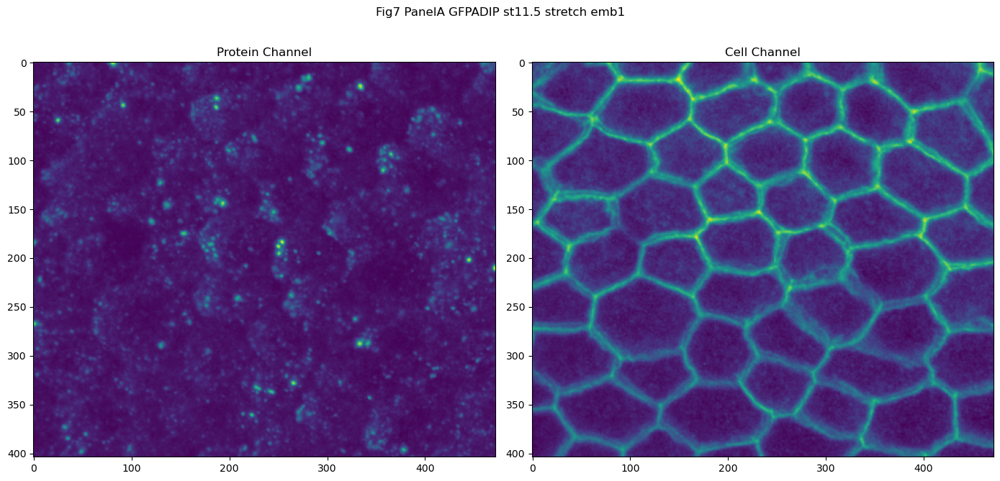

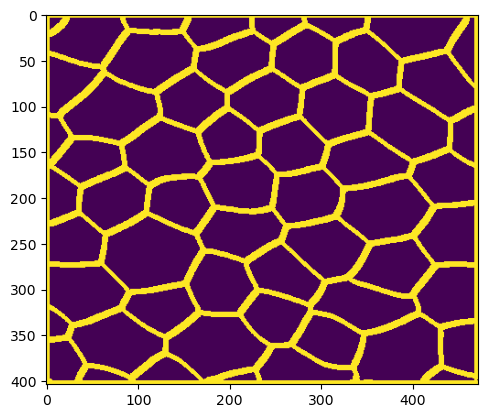

(404, 472)


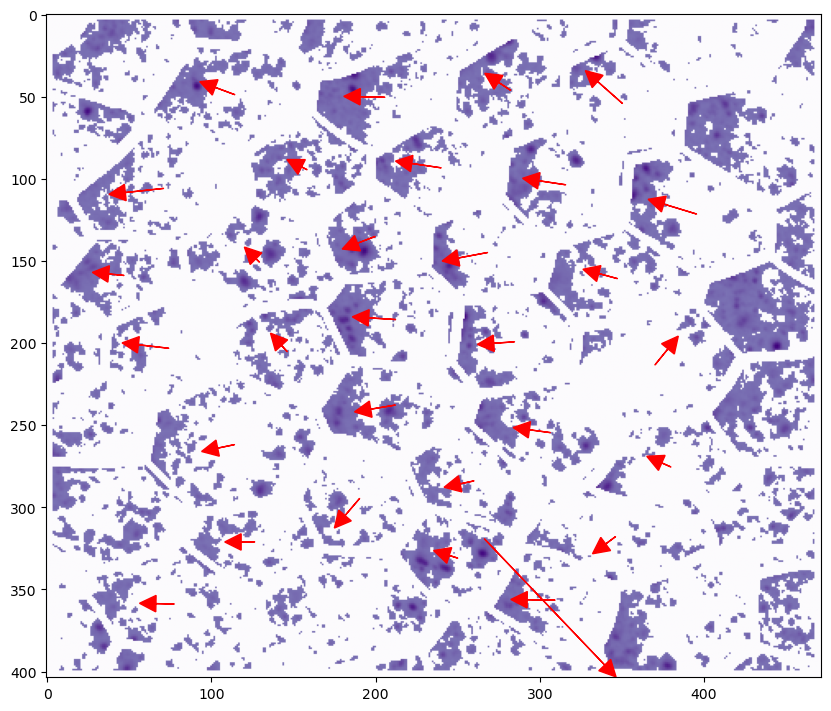

Finished actin analysis of Fig7 PanelA GFPADIP st11.5 stretch emb1
Finished actin null_model analysis of Fig7 PanelA GFPADIP st11.5 stretch emb1
106 825
AC 0
Doing analysis of Fig7 PanelA GFPADIP st11.5 stretch emb2


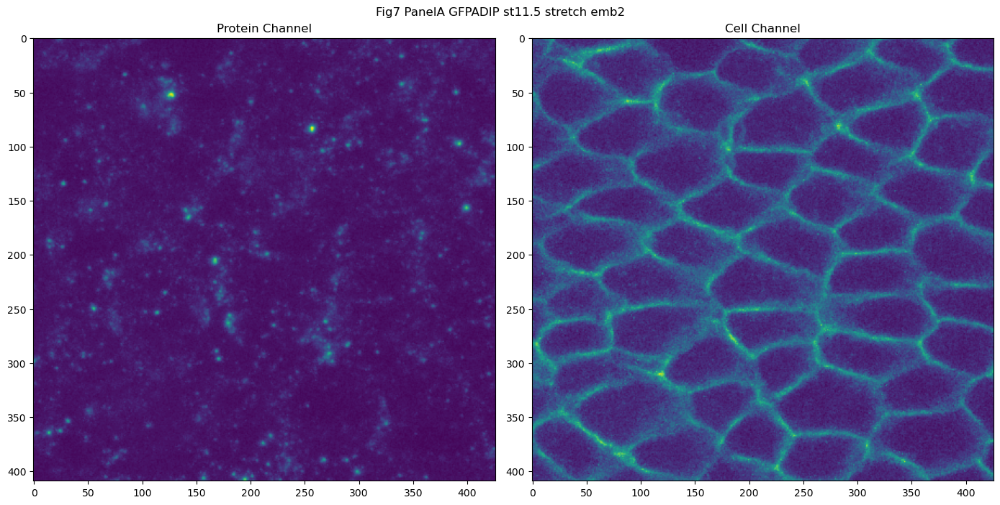

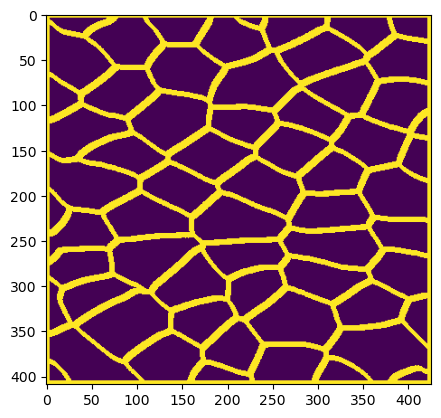

(409, 426)


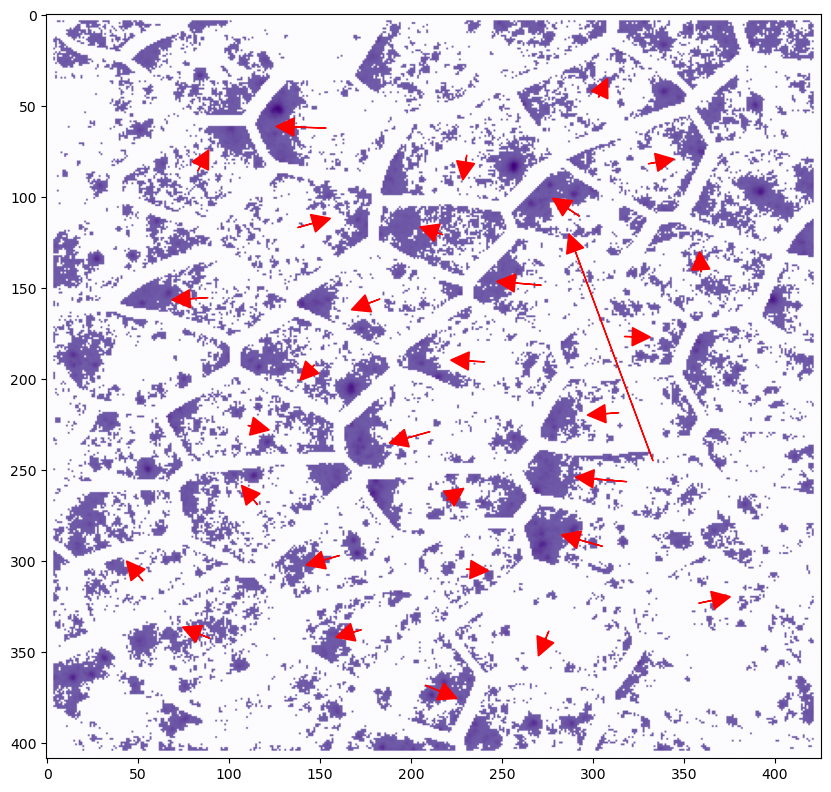

Finished actin analysis of Fig7 PanelA GFPADIP st11.5 stretch emb2
Finished actin null_model analysis of Fig7 PanelA GFPADIP st11.5 stretch emb2
104 5258
AC 0
Doing analysis of Fig7 PanelA GFPADIP st11.5 stretch emb3


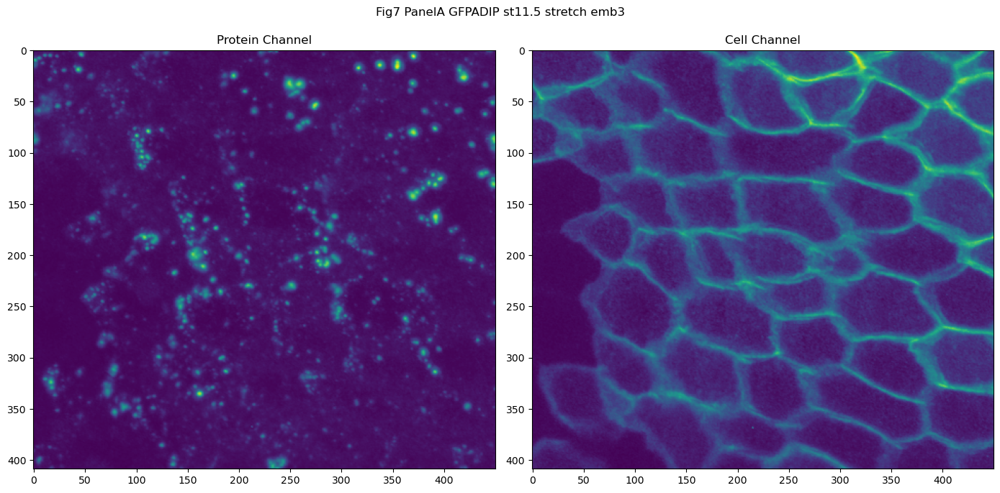

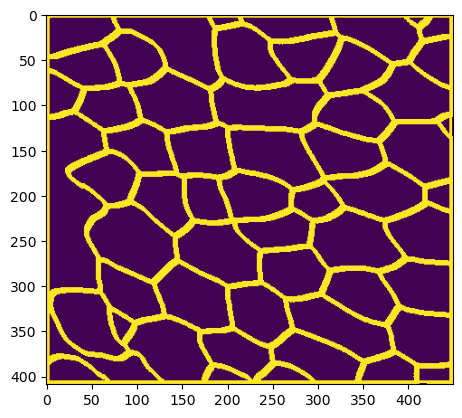

(409, 450)


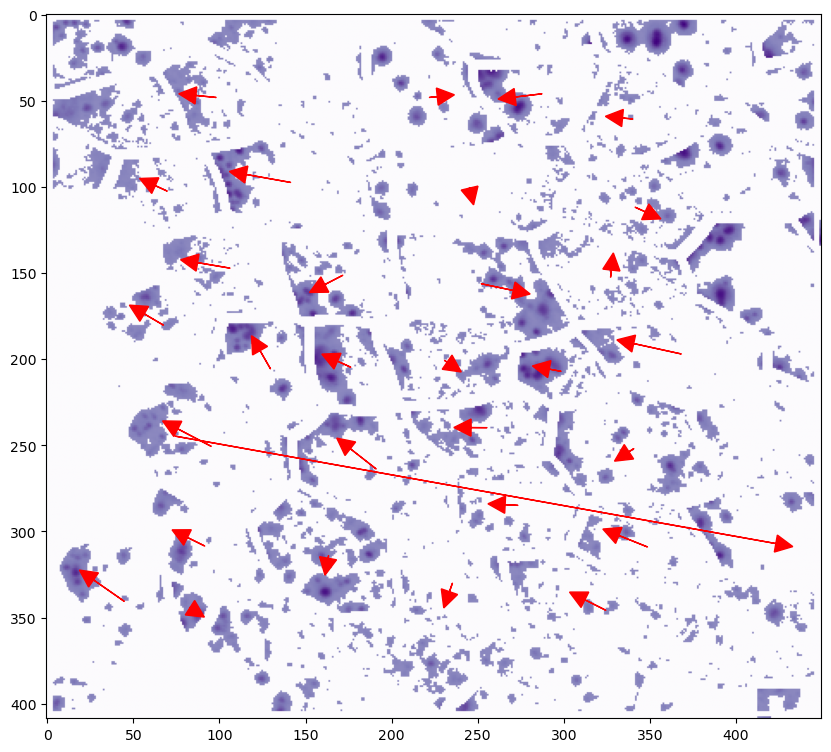

Finished actin analysis of Fig7 PanelA GFPADIP st11.5 stretch emb3
Finished actin null_model analysis of Fig7 PanelA GFPADIP st11.5 stretch emb3
ERROR:  File type not supported for masks
ERROR:  File type not supported for results
WORKING ON FOLDER:  From Satheeja to Jakob/Fig7 Stretch with Morphants/Fig7 PanelB ADIP+DivMO Stretch
ERROR:  File type not supported for channels.txt
104 630
AC 0
Doing analysis of Fig7 PanelB ADIP+DivMO st11.5 stretch emb1


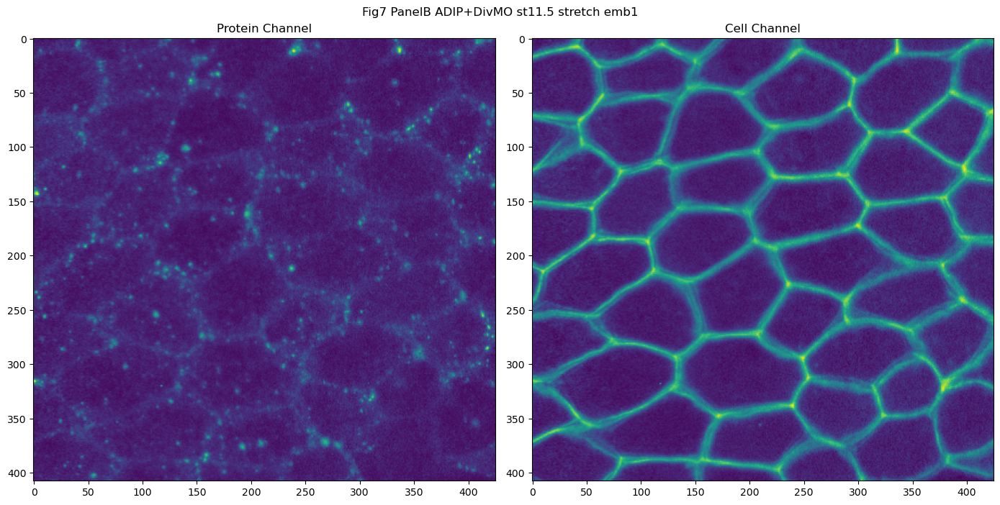

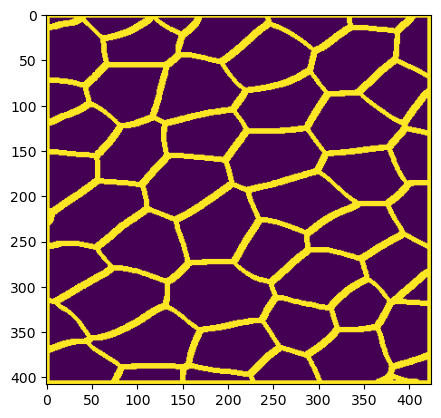

(408, 425)


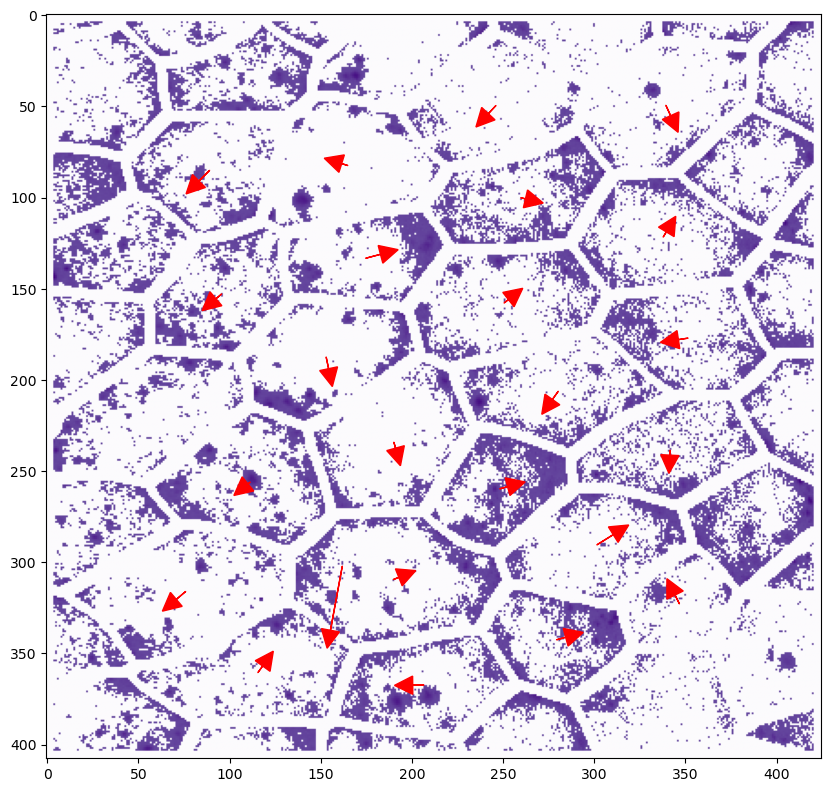

Finished actin analysis of Fig7 PanelB ADIPDivMO st11.5 stretch emb1
Finished actin null_model analysis of Fig7 PanelB ADIPDivMO st11.5 stretch emb1
107 2687
AC 0
Doing analysis of Fig7 PanelB ADIP+DivMO st11.5 stretch emb2


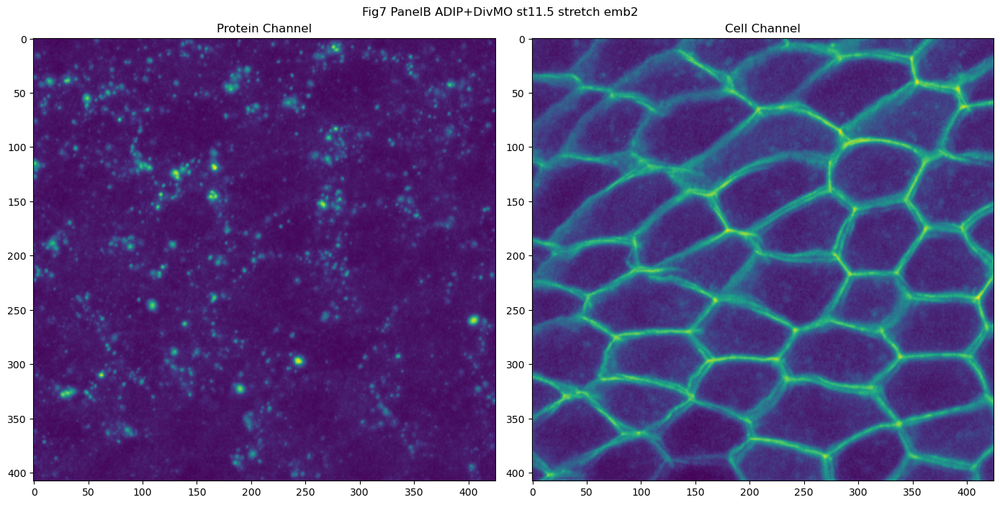

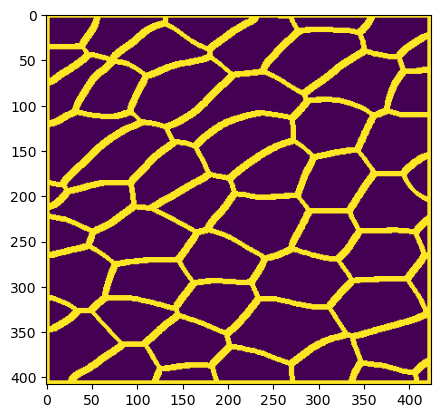

(408, 425)


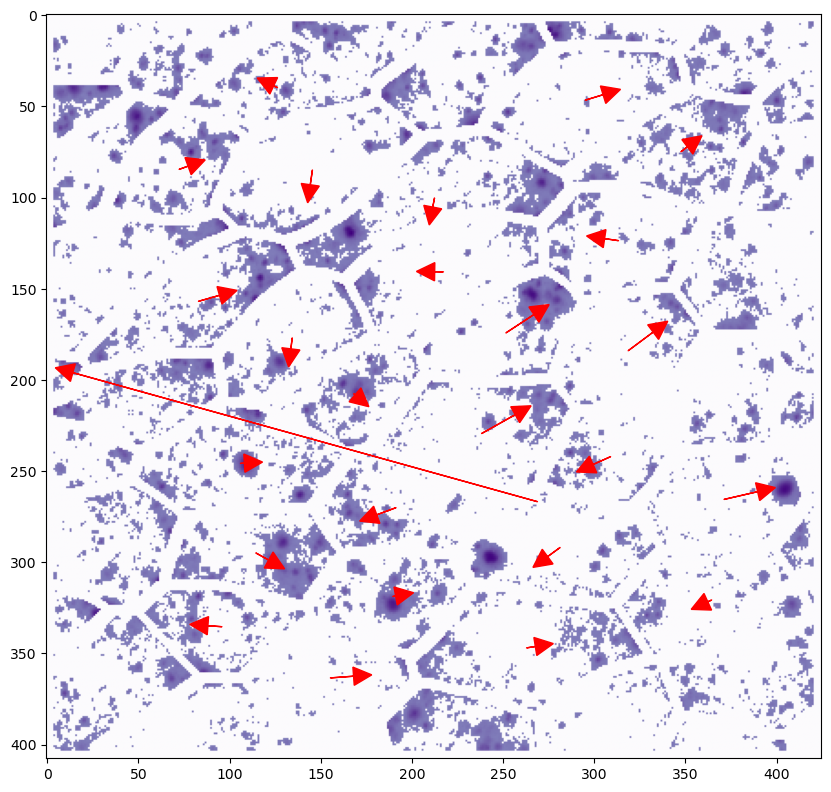

Finished actin analysis of Fig7 PanelB ADIPDivMO st11.5 stretch emb2
Finished actin null_model analysis of Fig7 PanelB ADIPDivMO st11.5 stretch emb2
109 1722
AC 0
Doing analysis of Fig7 PanelB ADIP+DivMO st11.5 stretch emb3


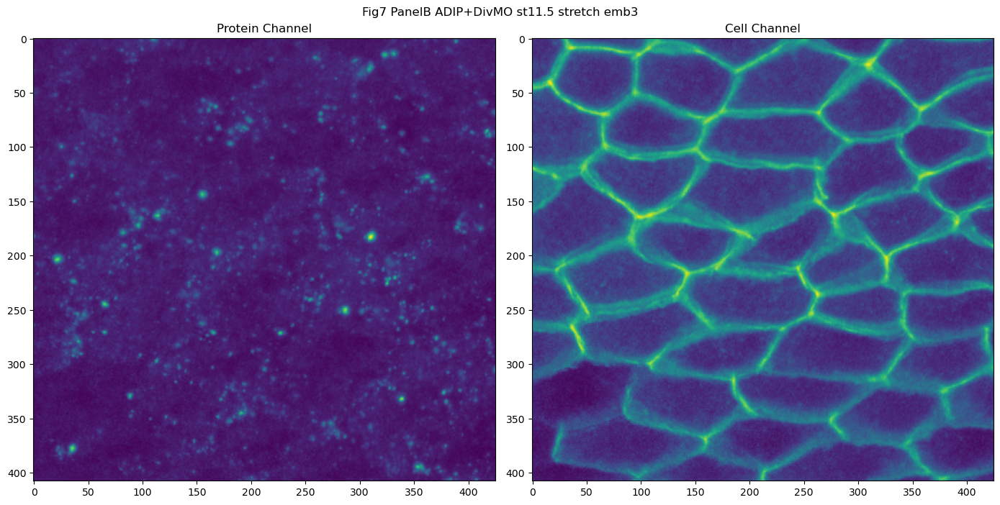

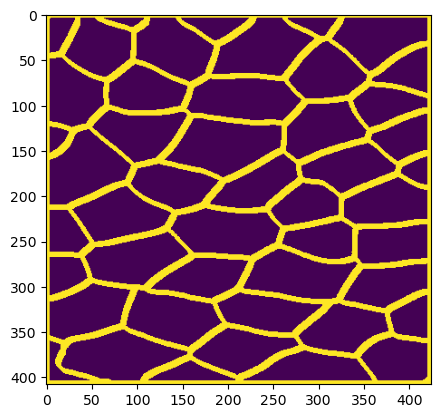

(408, 425)


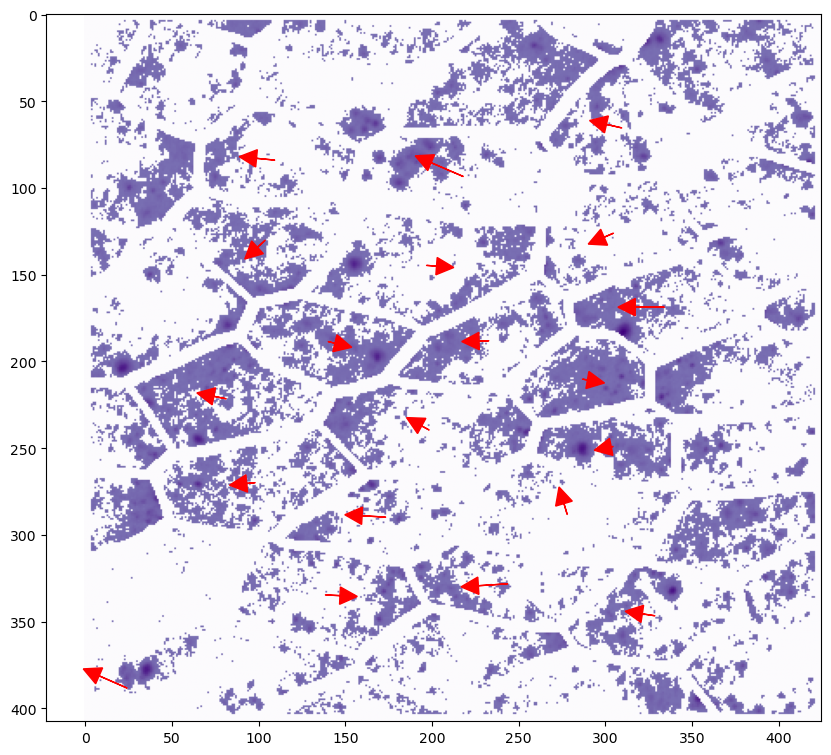

Finished actin analysis of Fig7 PanelB ADIPDivMO st11.5 stretch emb3
Finished actin null_model analysis of Fig7 PanelB ADIPDivMO st11.5 stretch emb3
ERROR:  File type not supported for masks
ERROR:  File type not supported for results
WORKING ON FOLDER:  From Satheeja to Jakob/Fig7 Stretch with Morphants/Fig7 PanelC Div Stretch
ERROR:  File type not supported for channels.txt
102 348
AC 0
Doing analysis of Fig7 PanelC HRDiv st11.5 stretch emb1


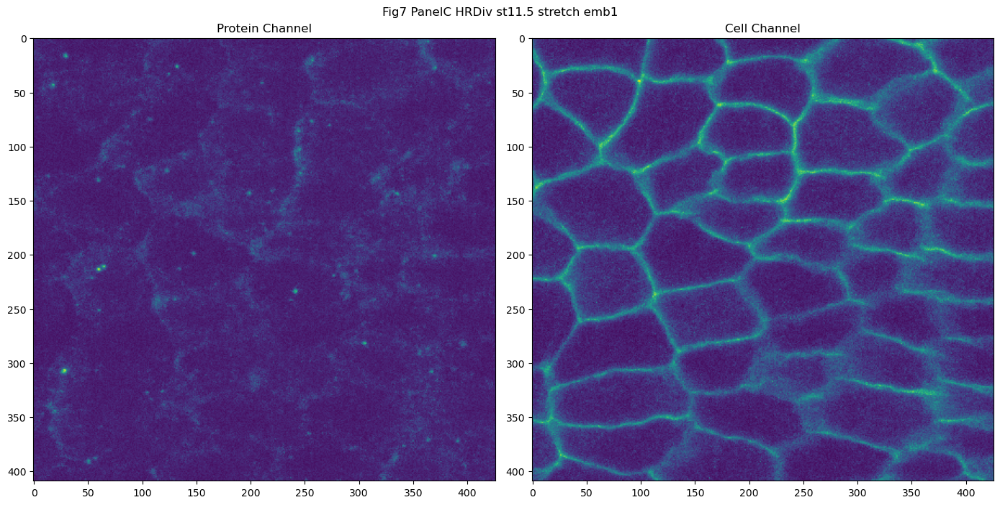

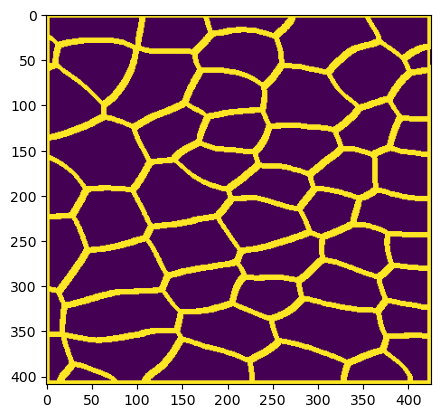

(409, 426)


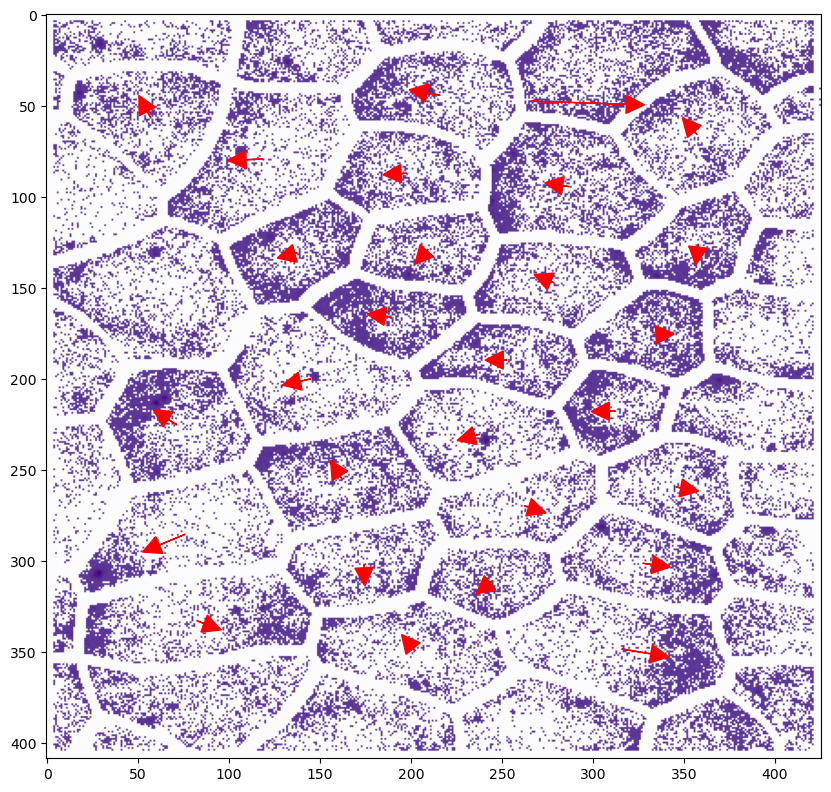

Finished actin analysis of Fig7 PanelC HRDiv st11.5 stretch emb1
Finished actin null_model analysis of Fig7 PanelC HRDiv st11.5 stretch emb1
101 597
AC 0
Doing analysis of Fig7 PanelC HRDiv st11.5 stretch emb2


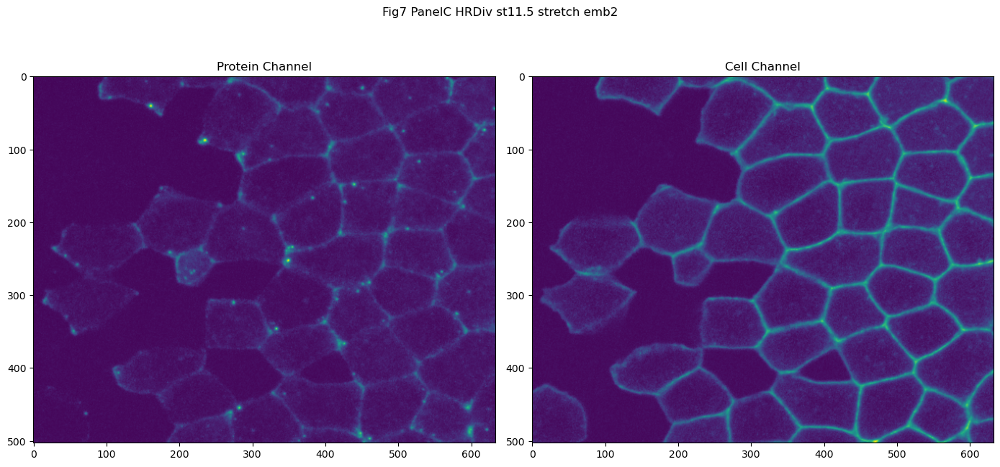

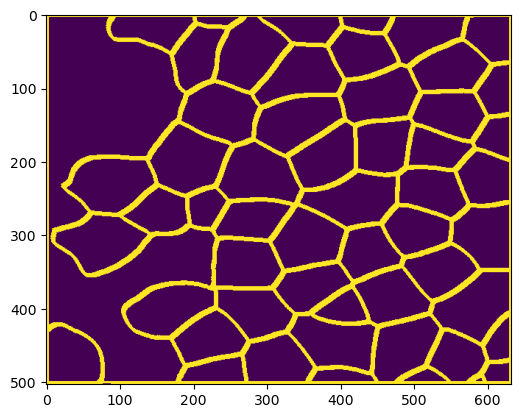

(503, 633)


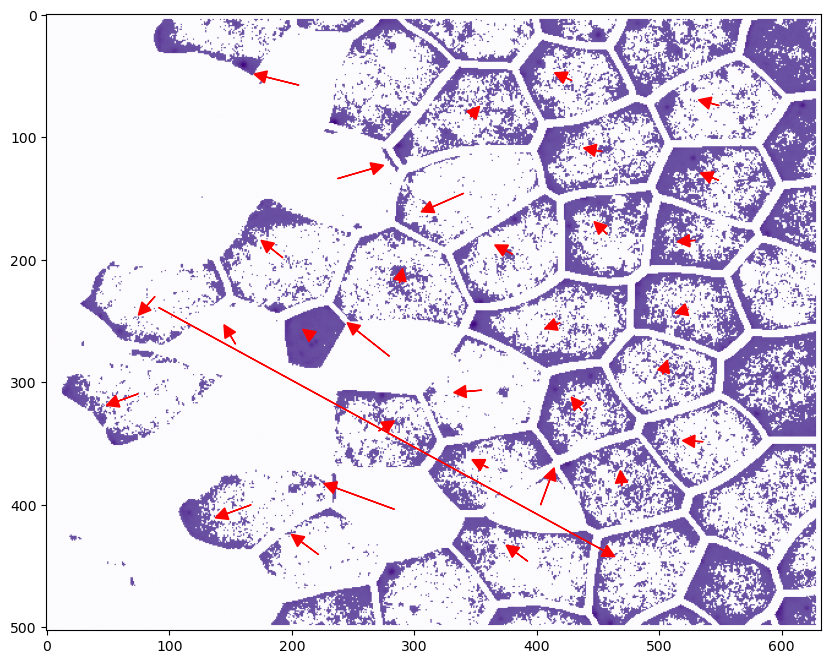

Finished actin analysis of Fig7 PanelC HRDiv st11.5 stretch emb2
Finished actin null_model analysis of Fig7 PanelC HRDiv st11.5 stretch emb2
20 660
AC 0
Doing analysis of Fig7 PanelC HRDiv st11.5 stretch emb3


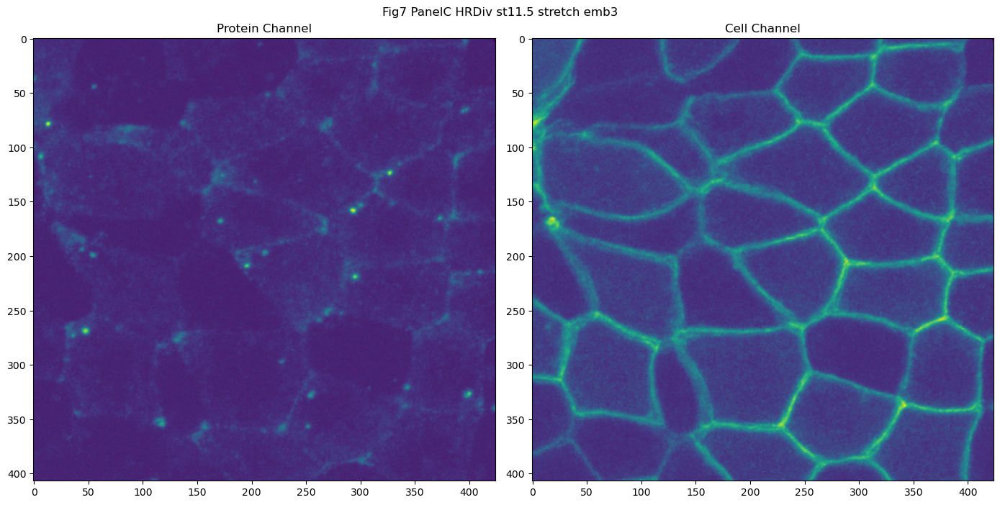

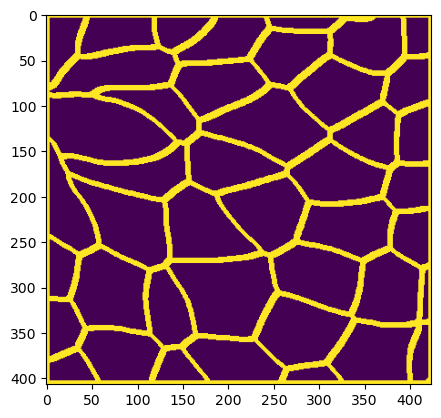

(407, 424)


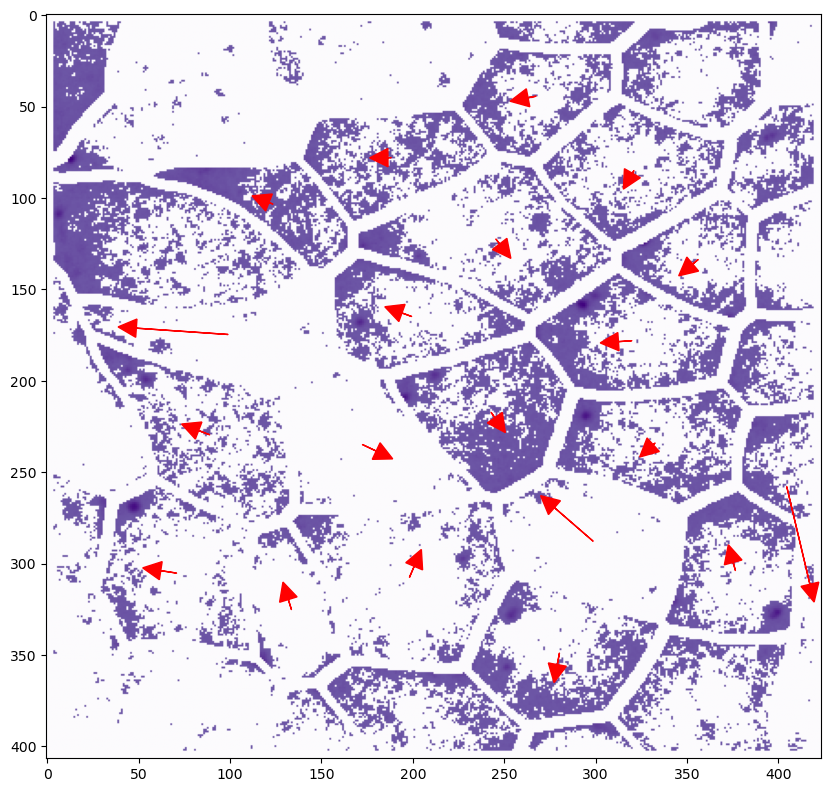

Finished actin analysis of Fig7 PanelC HRDiv st11.5 stretch emb3
Finished actin null_model analysis of Fig7 PanelC HRDiv st11.5 stretch emb3
ERROR:  File type not supported for masks
ERROR:  File type not supported for results
WORKING ON FOLDER:  From Satheeja to Jakob/Fig7 Stretch with Morphants/Fig7 PanelD Div+ADIPMO stretch
ERROR:  File type not supported for channels.txt
111 1644
AC 0
Doing analysis of Fig7 PanelD Div+ADIPMO st11.5 stretch emb1


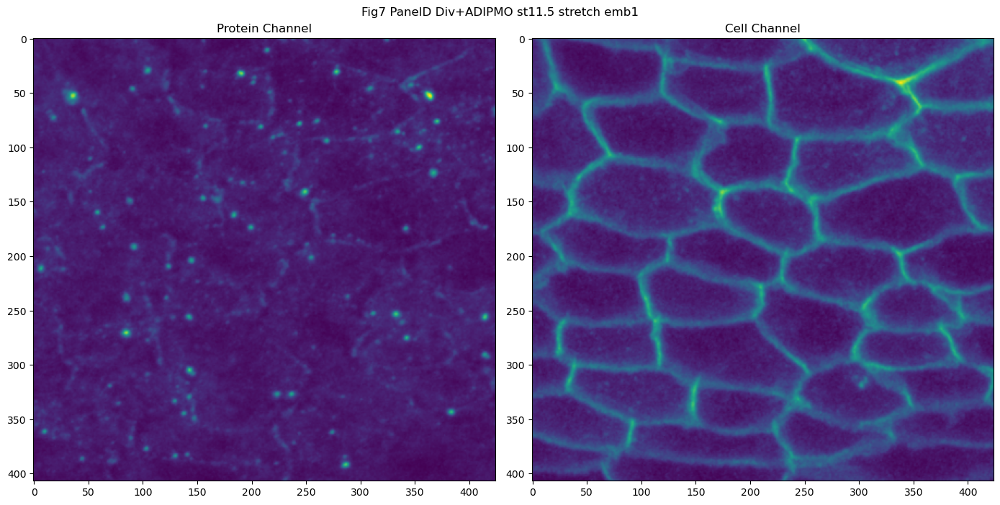

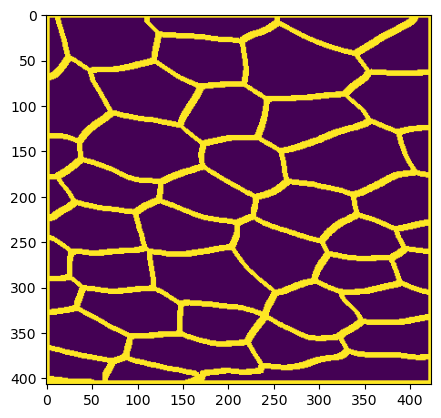

(407, 424)


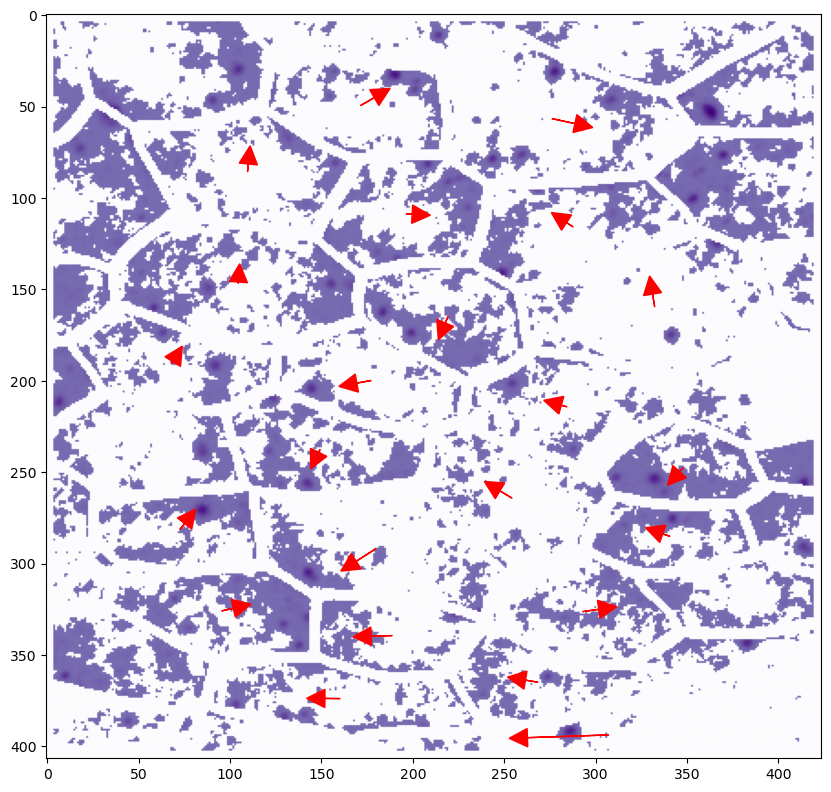

Finished actin analysis of Fig7 PanelD DivADIPMO st11.5 stretch emb1
Finished actin null_model analysis of Fig7 PanelD DivADIPMO st11.5 stretch emb1
111 2540
AC 0
Doing analysis of Fig7 PanelD Div+ADIPMO st11.5 stretch emb2


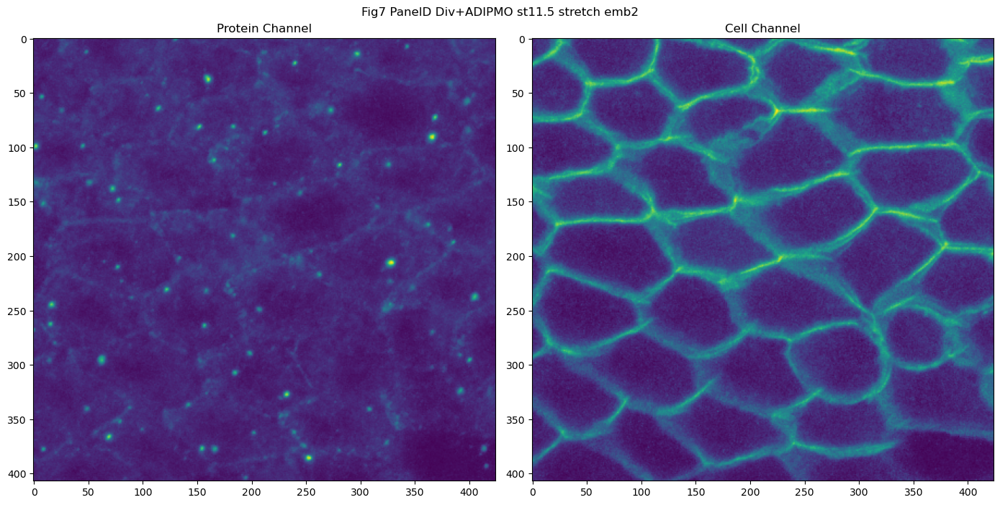

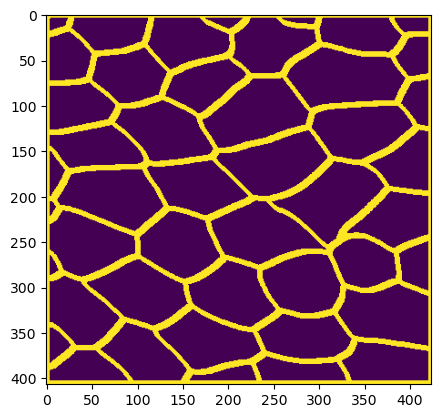

(407, 424)


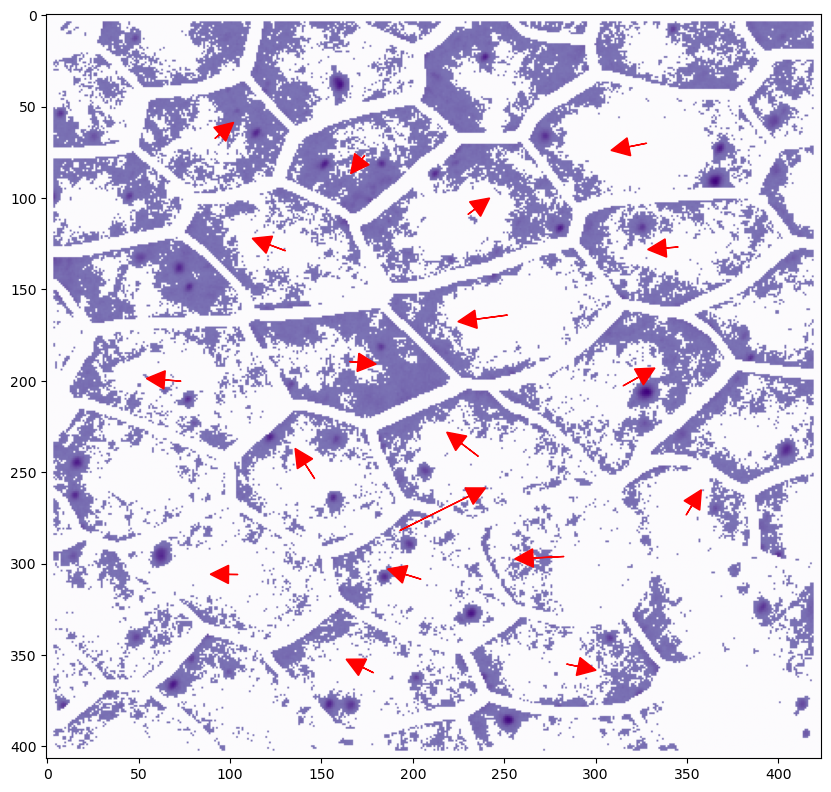

Finished actin analysis of Fig7 PanelD DivADIPMO st11.5 stretch emb2
Finished actin null_model analysis of Fig7 PanelD DivADIPMO st11.5 stretch emb2
105 526
AC 0
Doing analysis of Fig7 PanelD Div+ADIPMO st11.5 stretch emb3


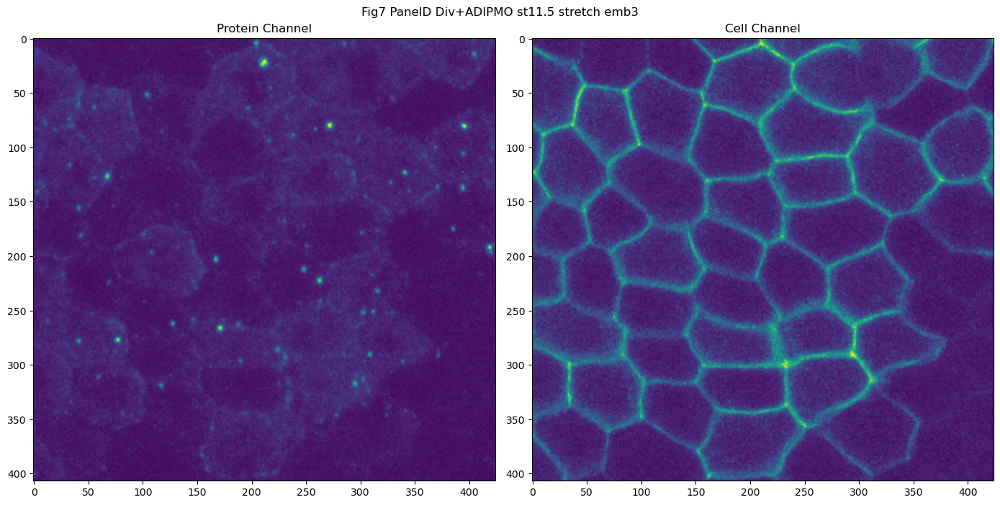

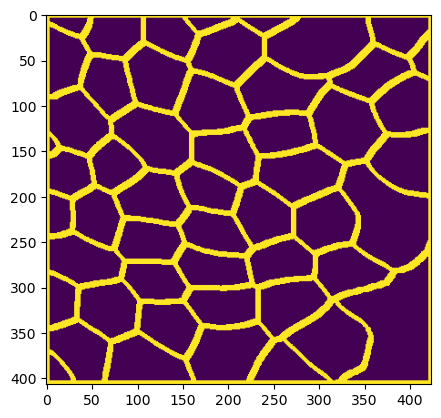

(407, 424)


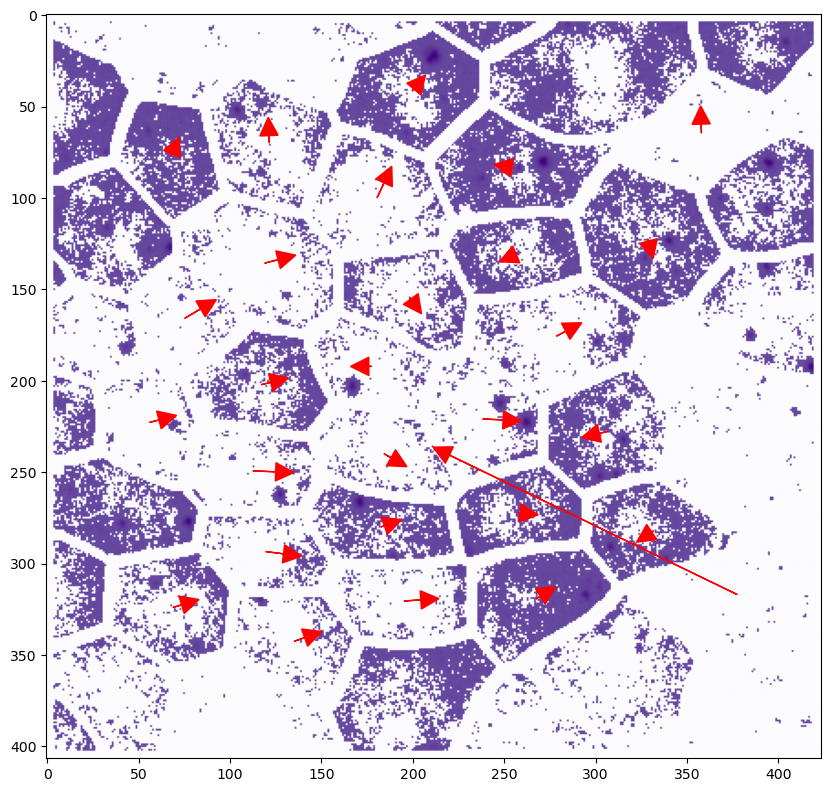

Finished actin analysis of Fig7 PanelD DivADIPMO st11.5 stretch emb3
Finished actin null_model analysis of Fig7 PanelD DivADIPMO st11.5 stretch emb3
ERROR:  File type not supported for masks
ERROR:  File type not supported for results


In [ ]:


show_images = True

do_protein_analysis = False
do_corner_analysis = False
do_actin_analysis = True

do_actin_null_model = True


iiii = 0
# for every folder in the path
for fold in all_folders.keys():
    # if not "R2-4" in fold:
    # if not "Fig7" in fold:
        # continue 
    # if not "New Fig1" in fold:
    #     continue 
    if not "Fig7 Panel" in fold:# and not "Fig R2-5" in fold:
        continue
    # if not "Fig7" in fold and not "Fig2-Shrm3" in fold and not "ADIP in NP" in fold:
    #     continue

    if not all_folders[fold]["is_valid"]:
        continue

    path = super_path + fold +"/"

    channels = all_folders[fold]["channels"]
    print("WORKING ON FOLDER: ", fold)


    for img_dir in os.listdir(path + "/"):
        # extract the name
        img_name = img_dir.replace(".png","").replace(".tiff","").replace(".tif","")#.replace("+","")
        

        # read in the image
        try:
            img_nolog = read_image(path + "/" + img_dir)
            img = preprocess_image(img_nolog)
        except Exception as e:
            print("ERROR: ", e, "for", img_dir)
            continue
        
        
        isvideo = len(img.shape) == 4

        img_analysis = lambda ximg, ximg_name: do_single_image_analysis(fold, ximg, ximg_name, show_images = show_images, do_corner_analysis = do_corner_analysis, do_protein_analysis = do_protein_analysis, do_actin_analysis=do_actin_analysis, do_actin_null_model=do_actin_null_model)
        
        # if image is video (ie. if it has a 4th dimension)
        if not isvideo:
            img_analysis(img, img_name)
        else:        
            print("Video detected")
            for i in range(img.shape[0]):
                if iiii < -1:
                    iiii += 1
                    continue
                img_single = img[i,:,:,:]
                frame_img_name =  "frame_" + str(i) +"_" + img_name
                print(iiii)
                img_analysis(img_single, frame_img_name)
                iiii += 1

            

